# CA1 Part B: Regression

![houses](./assets/img/houses.jpg)

|  |  |
| --- | --- |
| Name | Tan Yu Hoe |
| Admission Number | P2026309 |
| Class | DAAA/FT/2A/04 |

**Description**

This dataset contains house sale prices for King County, which includes Seattle. It includes homes sold between May 2014 and May 2015. The dataset also included attributes of the houses for each sale observation.

**Task**

1. Write the code to solve the prediction task.
2. **In the Jupyter notebook**, write your report detailing your implementation your experiments and analysis.

---

## Getting started

For the first step, I will be import some relevant libraries which might be useful for me to handle the data and create some visualisations. Furthermore, I will import pandas profiling to do a rough profiling and sklearn for machine learning.


In [1]:
# Data Manipulation
import numpy as np
import pandas as pd
# Data Visualisation
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
plt.style.use('ggplot')
# Misc
import os
from warnings import filterwarnings
from statsmodels.graphics.gofplots import qqplot
import math
import plotly.express as px
import plotly.graph_objects as go

In [2]:
# Updating on local environtment (Google Colab is outdated)
import sys
!{sys.executable} -m pip install -U pandas-profiling[notebook]
!jupyter nbextension enable --py widgetsnbextension
!pip install -U yellowbrick
# EDA Report
from pandas_profiling import ProfileReport

Requirement already up-to-date: pandas-profiling[notebook] in d:\anaconda3_v2\lib\site-packages (3.0.0)
Enabling notebook extension jupyter-js-widgets/extension...
      - Validating: ok
Requirement already up-to-date: yellowbrick in d:\anaconda3_v2\lib\site-packages (1.3.post1)


In [3]:
# preprocessing
from sklearn.compose import (
    ColumnTransformer,
    TransformedTargetRegressor
)
from sklearn.preprocessing import (
    MinMaxScaler,
    StandardScaler,
    FunctionTransformer
)
# model selection
from sklearn.model_selection import (
    cross_val_score,
    cross_validate
)
from yellowbrick.model_selection import (
    LearningCurve,
    ValidationCurve
)
from yellowbrick.regressor import ResidualsPlot
# Pipeline
from sklearn.pipeline import Pipeline
# Metrics
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_absolute_percentage_error
# Models
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import AdaBoostRegressor
from sklearn.ensemble import BaggingRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.ensemble import BaggingRegressor
from sklearn.svm import SVR
from sklearn.linear_model import Ridge
from sklearn.linear_model import SGDRegressor
from sklearn.linear_model import ElasticNet
from sklearn.linear_model import Lasso
from sklearn.svm import SVR
from sklearn.neural_network import MLPRegressor

---

## The Prediction Task

- How is the prediction task defined?

We are given a dataset containing house sale prices for King County and other attribute of each house sale. The prediction task is to create a predictive regression model to predict the house prices based of the house sales’ attribute given.

- What is the meaning of the output variable?

The output variable is `price`, refering to the price of the house sale. The variable is numerical-continuous variable, as such the prediction task requires a regression model.

### Metadata

| column | description | type |
| --- | --- | --- |
| id | house id | nominal |
| date | date of sale | continuous |
| price | price of sale | continuous |
| bedrooms | number of bedrooms | discrete |
| bathrooms | number of bathrooms | discrete |
| sqft_living | floor area of interior living area in square feet | continuous |
| sqft_lot | floor area of surrounding land area in square feet | continuous |
| waterfront | house is overlooking a waterfront area | categorical-binary |
| view | an index from 0 to 4 how good the view of the property | categorical-ordinal |
| condition | condition of the house from 1 to 5 | categorical-ordinal |
| grade | An index from 1 to 13, where 1-3 falls short of building construction and design, 7 has an average level of construction and design, and 11-13 have a high quality level of construction and design | discrete
| sqft_above | area of interior house space above ground levels in square feet | continuous |
| sqft_basement | area of the interior basement in square feet | continuous |
| yr_built | the year the house was built | continuous |
| yr_renovated | the year the house was last renovated |
| zipcode | a code to represent a certain area the house is located at | discrete |
| long | longitude | continuous |
| lat | latitude | continuous |
| sqft_living15 | The square footage of interior housing living space for the nearest 15 neighbors | continuous |
| sqft_lot15 | The square footage of the land lots of the nearest 15 neighbors | continuous |

In [4]:
# reading .csv file
house_data = pd.read_csv('./assets/house_data/kc_house_data.csv')
house_data.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


---

## Exploratory Data Analysis

> <i>"If you torture the data long enougb, it will confess to anything"</i> ~ Ronald Coarse

I am going to examine the dataset on houses in King County, Washington DC, USA. This dataset contains detailed information on each house sales on price and some predictor variable.

Contents I want to cover under EDA:

1. Data Structure
2. Analysis on Target Variable, Price
3. Data Profiling
4. Analysis on Columns
5. Correlation

### 1. Data Structure

Questions to Answer:
- How many features is in the dataset?
- How many observation is in the dataset?
- What is the data type of each feature?
- Are there missing/null values in the dataset?
- Descriptive Statistics

In [5]:
# Checking the dataset
house_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   date           21613 non-null  object 
 2   price          21613 non-null  float64
 3   bedrooms       21613 non-null  int64  
 4   bathrooms      21613 non-null  float64
 5   sqft_living    21613 non-null  int64  
 6   sqft_lot       21613 non-null  int64  
 7   floors         21613 non-null  float64
 8   waterfront     21613 non-null  int64  
 9   view           21613 non-null  int64  
 10  condition      21613 non-null  int64  
 11  grade          21613 non-null  int64  
 12  sqft_above     21613 non-null  int64  
 13  sqft_basement  21613 non-null  int64  
 14  yr_built       21613 non-null  int64  
 15  yr_renovated   21613 non-null  int64  
 16  zipcode        21613 non-null  int64  
 17  lat            21613 non-null  float64
 18  long  

** Observations **

- shape: (21613, 22)
- `date` is in a string format - convert to datetime object
- all columns (except 'date) are numerical, either float64 or int64
- no missing values - no imputation needed
- `id` aka unique identifying key - not needed as a feature

In [6]:
# Converting date to datetime dtype
house_data['date'] = pd.to_datetime(house_data['date'])

In [7]:
# Descriptive Statistics
house_data.describe().T

,count,mean,std,min,25%,50%,75%,max
id,21613.0,4.580302e+09,2.876566e+09,1.000102e+06,2.123049e+09,3.904930e+09,7.308900e+09,9.900000e+09
price,21613.0,5.400881e+05,3.671272e+05,7.500000e+04,3.219500e+05,4.500000e+05,6.450000e+05,7.700000e+06
bedrooms,21613.0,3.370842e+00,9.300618e-01,0.000000e+00,3.000000e+00,3.000000e+00,4.000000e+00,3.300000e+01
bathrooms,21613.0,2.114757e+00,7.701632e-01,0.000000e+00,1.750000e+00,2.250000e+00,2.500000e+00,8.000000e+00
sqft_living,21613.0,2.079900e+03,9.184409e+02,2.900000e+02,1.427000e+03,1.910000e+03,2.550000e+03,1.354000e+04
sqft_lot,21613.0,1.510697e+04,4.142051e+04,5.200000e+02,5.040000e+03,7.618000e+03,1.068800e+04,1.651359e+06
floors,21613.0,1.494309e+00,5.399889e-01,1.000000e+00,1.000000e+00,1.500000e+00,2.000000e+00,3.500000e+00
waterfront,21613.0,7.541757e-03,8.651720e-02,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00
view,21613.0,2.343034e-01,7.663176e-01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,4.000000e+00
condition,21613.0,3.409430e+00,6.507430e-01,1.000000e+00,3.000000e+00,3.000000e+00,4.000000e+00,5.000000e+00


### 2. Analysis on Target Variable, `Price`

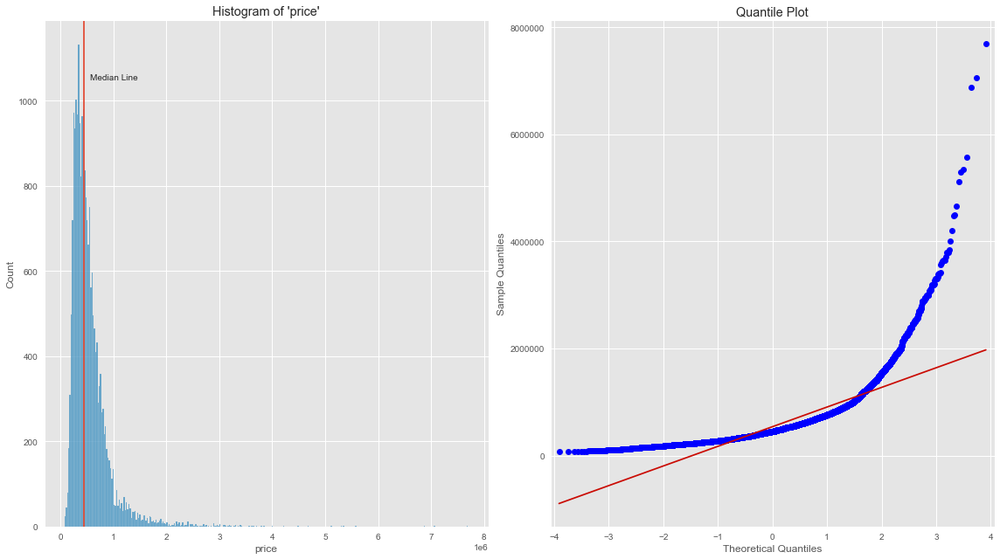

In [8]:
# distribution of price
with plt.style.context('ggplot'):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 9), tight_layout=True)
    sns.histplot(x=house_data['price'], ax=ax1)
    qqplot(data=house_data['price'], ax=ax2, line='s')
    plt.ticklabel_format(style='plain')
    ax1.set_title(f"Histogram of 'price'")
    ax1.axvline(house_data['price'].median(), 0, 1)
    ax1.text(x=house_data['price'].median()+100000, y=1050, s='Median Line')
    ax2.set_title('Quantile Plot')
    plt.show()

**Observation**
- Histogram does not follow a gaussian distribution, with a right tail extending out
- Quantile plot shows positive skewness
- price likely need to undergo log/power transformation to get a gaussian distribution

### 3. Data Profiling

In order to get some awareness in the dataset, I will be using `pandas_profiling` library to do a profile on the dataset to check for any issues.

p.s. for better viewability, I have exported the profile to a `.html` file under `/assets`, it would be advised to view in browser instead of the notebook.

In [9]:
# Create Profiling on the dataset
profile = ProfileReport(house_data, orange_mode=True, title='Kings County House Prices Dataset Profile')
profile.to_notebook_iframe()

Render HTML: 100%|██████████| 1/1 [00:10<00:00, 10.61s/it]


In [10]:
import os
os.makedirs('./assets', exist_ok=True)
profile.to_file('./assets/profile/house_profile.html')

Export report to file: 100%|██████████| 1/1 [00:00<00:00,  3.48it/s]


** Observations **

- sqft_basement has 60.7% zeros - drop column due to surplus of missing information
- yr_renovated has 95.8% zeros - I might use it later for feature engineering
- multiple warnings on correlation - have to check for collinearlity

### 4. Analysis on Columns

In [11]:
# plotting out a map using plotly and mapbox
px.set_mapbox_access_token("pk.eyJ1IjoidHloNzEiLCJhIjoiY2tocmNoMzFiMGh4aTJxa3phZ2xxZ2VvbSJ9.jxOlOsO__O-1ZbuBqxUq_A")
fig = px.scatter_mapbox(house_data, lat="lat", lon="long", color="price", color_continuous_scale='teal_r', size_max=15, zoom=9)
fig.update_traces(marker=dict(size=5, opacity=.2))
fig.update_layout(width=1200, height=800, mapbox_style="open-street-map")
fig.show()

**Observation**
- North West part of Seattle is cheaper
- Central area has more expensive houses
- location has an effect on price, lat and long is relevant

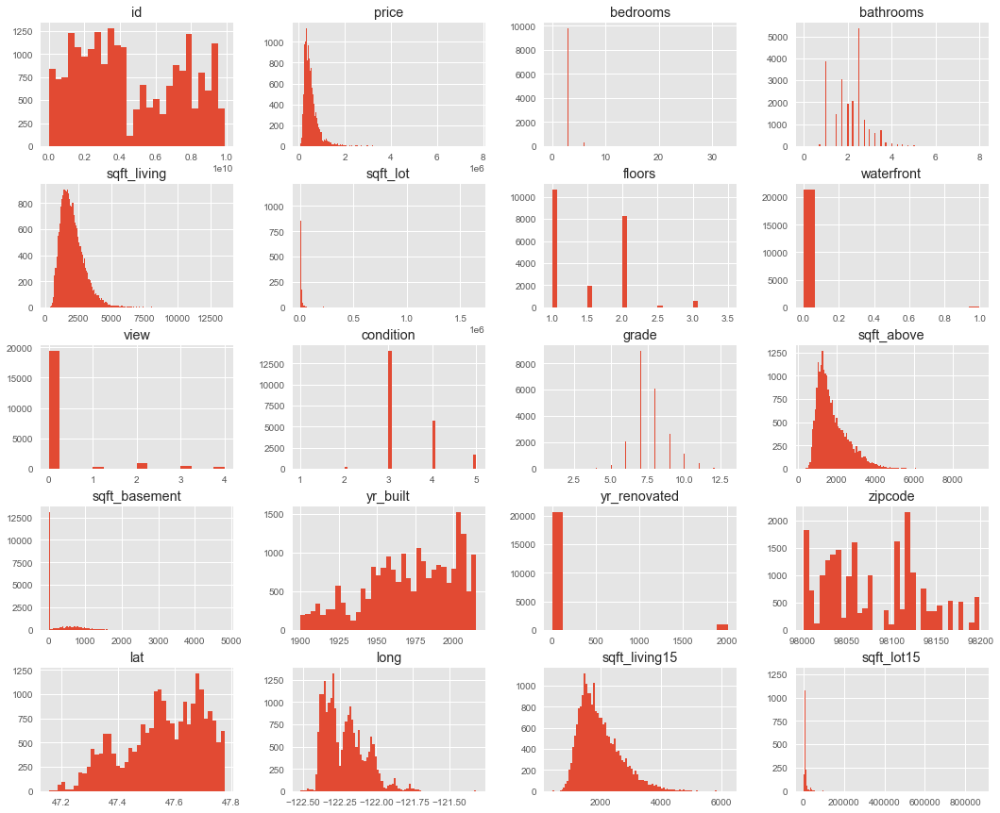

In [12]:
with plt.style.context('ggplot'):
    house_data.hist(figsize=(18, 15), bins='auto')
    plt.show()

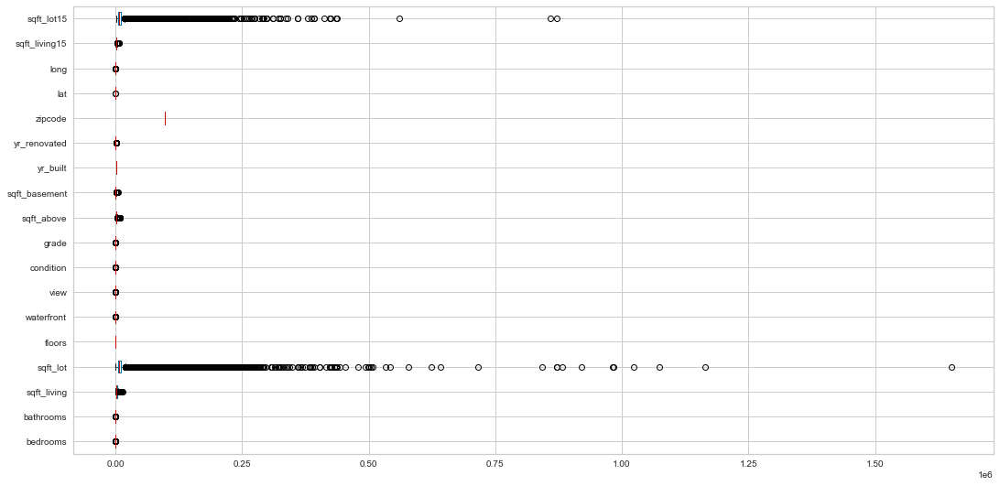

In [13]:
house_data.drop(['id', 'price'], axis=1).plot.box(figsize=(18, 9), vert=False)
plt.show()

**Observation**
- almost all columns listed in the histogram does not follow a normal distribution
- boxplot shows every columns is not in the same scale, probably need scaling 

### Correlation Matrix

Display Pearson's correlation between each columns. There are two reasons for doing this, checking for correlation with output variable, and checking for multicollinearity.

Why multicollinearity is bad?

Strong collinearlity between features can increase the variance of the coefficient estimates and risk overfitting.

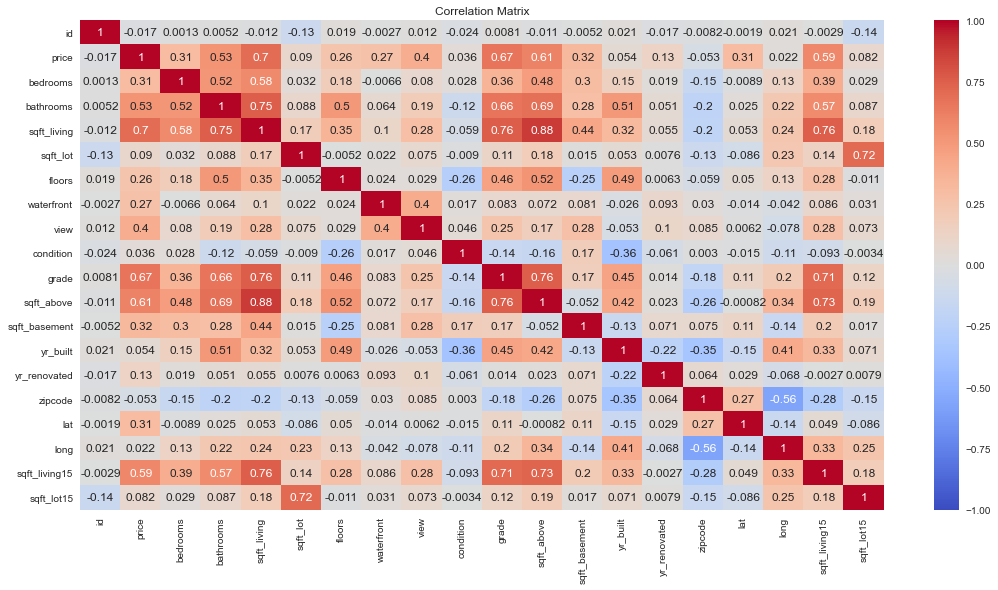

In [14]:
fig, ax = plt.subplots(figsize=(18, 9))
sns.heatmap(house_data.corr(), vmin=-1, vmax=1, annot=True, cmap='coolwarm', ax=ax)
ax.set_title("Correlation Matrix")
plt.show()

In [15]:
# making collinear
corr = house_data.corr().abs()
features = []
correlations = []
for idx, correlation in corr['price'].T.iteritems():
    if correlation >= .30 and idx != 'price':
        features.append(idx)
        correlations.append(correlation)
corr_with_price = pd.DataFrame({'Correlations':correlations, 'Features': features})

Multicollinear_Features = []
Multicollinear_Corr = []
def check_multicollinearity(feature):
    for idx, correlation in corr[feature].T.iteritems():
        if correlation >= .8 and idx != feature:
            Multicollinear_Features.append([feature, idx])
            Multicollinear_Corr.append(correlation)
for feature in corr:
    check_multicollinearity(feature)
MC_df = pd.DataFrame({'Correlations':Multicollinear_Corr, 'Features': Multicollinear_Features})
display(MC_df)

,Correlations,Features
0,0.876597,"[sqft_living, sqft_above]"
1,0.876597,"[sqft_above, sqft_living]"


** Observations **
- high collinearlity between sqft_living and sqft_above
- remove sqft_above as sqft_living has higher correlation with price

In [16]:
# checking for very weak correlation with price, abs(r) < .05
weak_corr = pd.DataFrame(house_data.corr().loc['price'][abs(house_data.corr().loc['price']) < 0.03])
list(weak_corr.index)

['id', 'long']

** Observations **
- these columns has very weak correlation with price 
    - 'id'

---

## Feature Engineering / Preprocessing

> extracting features from their domain; in summary, preparing the data before modelling

### Did you process the features in any way?

I will be splitting the data into training (80%) and testing set (20%). Looking at the skewed distribution, I will be applying Nomalisation on the target variable and the other featurs. Finally, I will be applying Min-Max Scaling on the features to ensure they are normalised - normalisation.

**List of Techniques used for this dataset**

1. House Age
2. Data Partition
3. Log Transformation
4. Normalisation
5. Target Transformation

### House Age

I am going to create a feature `age`, where age refers to the time difference between time of sales and time of renovation or time of built. There are some people which bought the house in 2014 but renovate in 2015, which the relative age is -1. To represent this information, I  will replace -1 with 0.

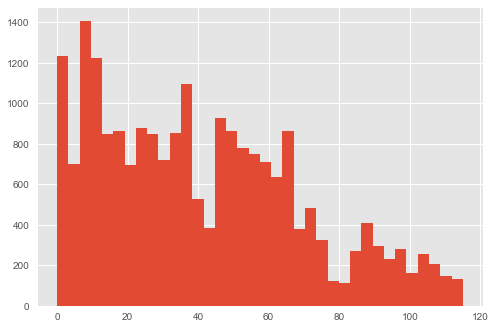

In [17]:
# computing age
house_data['age'] = (house_data['date'].dt.year - house_data['yr_renovated'].replace(0, np.nan).combine_first(house_data['yr_built'])).replace(-1, 0)
# plotting out age distribution
with plt.style.context('ggplot'):
    house_data['age'].hist(bins='auto')
    plt.show()

In [18]:
# checking the computing of age
house_data[['date', 'yr_renovated', 'yr_built', 'age']]

,date,yr_renovated,yr_built,age
0,2014-10-13,0,1955,59.0
1,2014-12-09,1991,1951,23.0
2,2015-02-25,0,1933,82.0
3,2014-12-09,0,1965,49.0
4,2015-02-18,0,1987,28.0
...,...,...,...,...
21608,2014-05-21,0,2009,5.0
21609,2015-02-23,0,2014,1.0
21610,2014-06-23,0,2009,5.0
21611,2015-01-16,0,2004,11.0


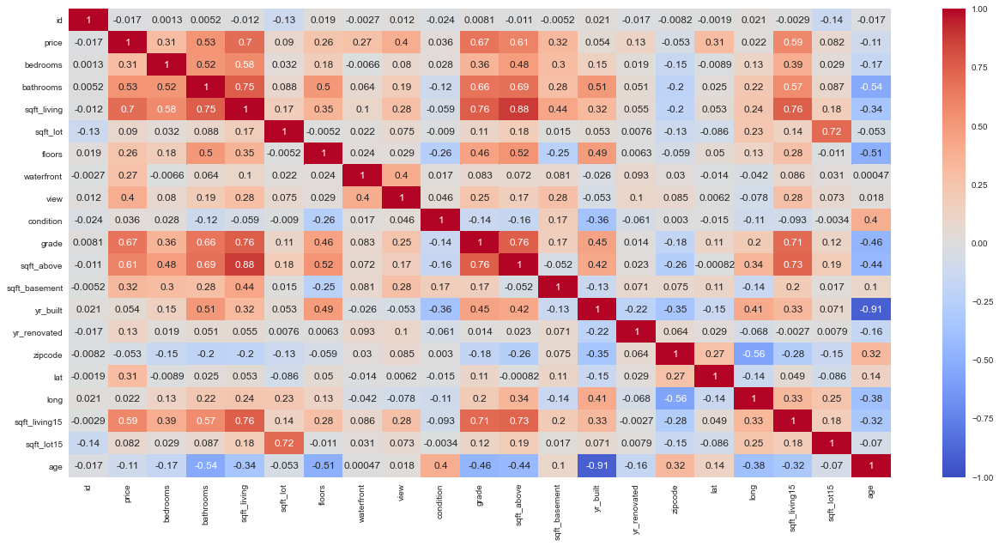

In [19]:
# checking age in a correlation matrix
fig, ax = plt.subplots(figsize=(18, 9), tight_layout=True)
sns.heatmap(house_data.corr(), vmin=-1, vmax=1, cmap='coolwarm', annot=True, ax=ax)
plt.show()

** Observation **

We can see very high collinearity between yr_built and age, as such I will drop `yr_built` as age as a high correlation with `price`

### 2. Data Partitioning

I will be doing Data Partitioning, aka train_test_split, first to prevent any data leakage to the testing set in the further steps. As mentioned above, I will be spltting the data to 8:2 ratio.

How do you represent your data as features?

I will be dropping these columns with reasons as follow

- id has very low correlation with price
- sqft basement and yr_renovated contains alot of zeros
- date is not useful here since we are not doing time-series predictive analytics
- yr_built has very high correlation with age

I will be using these columns as features for predictive modelling.

'bedrooms',
 'bathrooms',
 'sqft_living',
 'sqft_lot',
 'floors',
 'waterfront',
 'view',
 'condition',
 'grade',
 'zipcode',
 'lat',
 'long',
 'sqft_living15',
 'sqft_lot15',
 'age'

In [20]:
y = house_data['price']
X = house_data.drop(['id', 'sqft_basement', 'sqft_above', 'date', 'yr_built', 'yr_renovated'], axis=1).drop('price', axis=1)
X_col = X.columns
display(X.head())
print('X:', X.shape, '\ty:', y.shape)

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,zipcode,lat,long,sqft_living15,sqft_lot15,age
0,3,1.00,1180,5650,1.0,0,0,3,7,98178,47.5112,-122.257,1340,5650,59.0
1,3,2.25,2570,7242,2.0,0,0,3,7,98125,47.7210,-122.319,1690,7639,23.0
2,2,1.00,770,10000,1.0,0,0,3,6,98028,47.7379,-122.233,2720,8062,82.0
3,4,3.00,1960,5000,1.0,0,0,5,7,98136,47.5208,-122.393,1360,5000,49.0
4,3,2.00,1680,8080,1.0,0,0,3,8,98074,47.6168,-122.045,1800,7503,28.0


X: (21613, 15) 	y: (21613,)


In [21]:
# splitting into training and testing sets
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.2)
print('X_train:', X_train.shape, '\ty_train', y_train.shape)
print('X_test:', X_test.shape, '\ty_test', y_test.shape)

X_train: (17290, 15) 	y_train (17290,)
X_test: (4323, 15) 	y_test (4323,)


### 3\. Log Transformation

Noticed in the EDA that the distribution of the features are not normal. The tail of the skewed distribution might affect our regression model, as such we have to transform our feature using log transformation. Since sklearn does not have this function, we have to create our own custom function. Furthermore, I will be preselecting some features to transform as they are more extreme compared to the others.

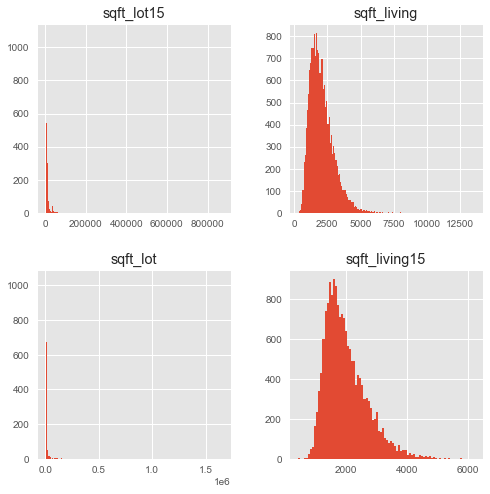

In [22]:
# defining continuous columns with outliers
outliers=['sqft_lot15', 'sqft_living', 'sqft_lot', 'sqft_living15']
# plotting out distribution before log transformation
with plt.style.context('ggplot'):
    X_train[outliers].hist(bins='auto', figsize=(8, 8))

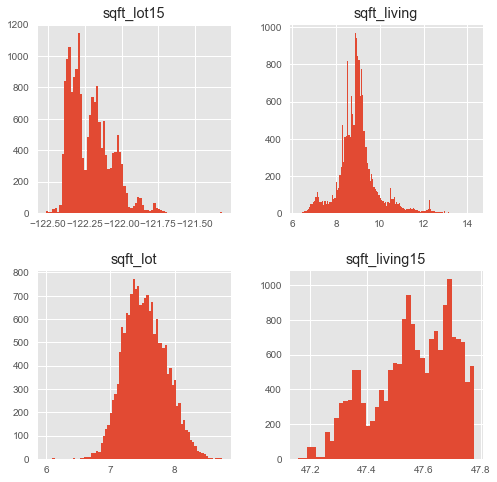

In [23]:
# initiate log transform inside column transformer
LogTransform = ColumnTransformer(
    transformers=[
        ('LogTransform', FunctionTransformer(func=np.log1p), outliers)
    ], remainder='passthrough'
)
LogTransform.fit(X_train)
# plotting out dsitribution after log transform
with plt.style.context('ggplot'):
    pd.DataFrame(LogTransform.fit_transform(X_train), columns=X_train.columns)[outliers].hist(bins='auto', figsize=(8, 8))
    plt.show()

### 3. Nomalisation

Noticed that quite a number of features do not have the same scale. Therefore, we have to perform feature scaling on the features. Futhermore, the features and the target variable do not follow Gaussian's Distribution (Normal Distribution). As such, we have to perform normalisation instead of standardisation.

$$ X_{Normalised} = \frac {X_i - X_{min}} {X_{max} - X_{min}} $$

Below shown are just a visual example of the effect of normalisation, I will be implementing sklearn's MinMaxScaler into a pipeline later on for better integrability.

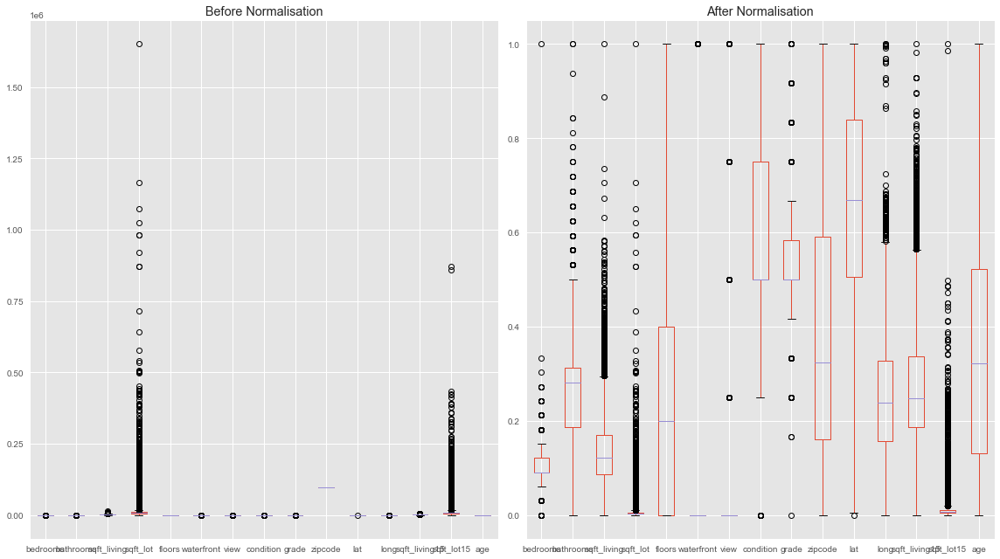

In [24]:
# demostration of MinMaxScaler
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
X_train_scale = pd.DataFrame(scaler.fit_transform(X_train), columns=X_col)
# plotting out boxplots
with plt.style.context('ggplot'):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 9), tight_layout=True)
    X_train.plot.box(vert=True, title='Before Normalisation', ax=ax1)
    X_train_scale.plot.box(vert=True, title='After Normalisation', ax=ax2)
    plt.show()

### 4. Target Transformation

Looking back in the EDA, price has a very skewed distribution. Skewness, the distortion from normal distribution, could affect regression learning algorithms performances. To counteract this problem, I will be applying LogTransformation on the target variable.

$$ X_{Transformed} = log_e(1 + X)$$

Question: Why + 1? Answer is because $log_e(0)$ will give us undefined value as it is not a real number.

Since I will be integrating sklearn `TransformedTargetRegressor` method, which applies log transformation for us, the following code will be used to demostrate the effects of log transformation.

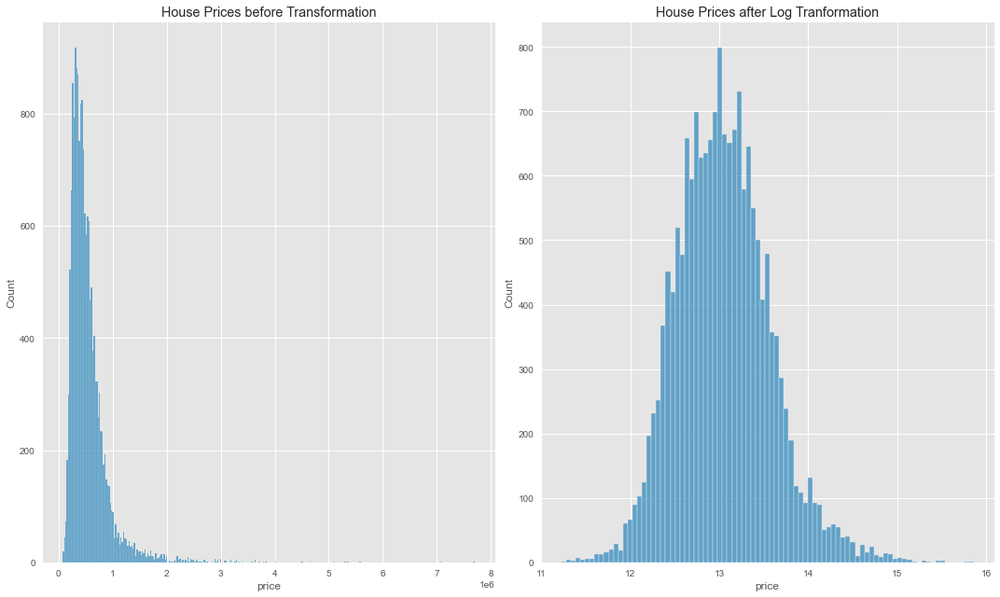

In [25]:
# plotting out distribution before and after log transform
with plt.style.context('ggplot'):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 9), tight_layout=True)
    # Original Data
    sns.histplot(y_train, ax=ax1)
    ax1.set_title('House Prices before Transformation')
    sns.histplot(y_train.apply(np.log1p), ax=ax2)
    ax2.set_title('House Prices after Log Tranformation')
    plt.show()

---

## Model Selection

How did you select which learning algorithms to use?

I will be running different models down and use k-fold cross validation with different regression metrics. To ensure a fair test, I will be excluding any other hyperparameters. The scoring metrics I will be implementing are root mean squared error, mean square erorr, mean absolute error, mean absolute percentage error and $R^2$.

In [26]:
# Initiate collection class to store all the Regressors
models = [
    ('LinearRegression', LinearRegression()),
    ('AdaBoostRegressor', BaggingRegressor()),
    ('GradientBoostingRegressor', GradientBoostingRegressor()),
    ('RandomForestRegressor', RandomForestRegressor()),
    ('KNeighborsRegressor', KNeighborsRegressor()),
    ('DecisionTreeRegressor', DecisionTreeRegressor()),
    ('ExtraTreesRegressor', ExtraTreesRegressor()),
    ('BaggingRegressor', BaggingRegressor()),
    ('Ridge', Ridge()),
    ('SGDRegressor', SGDRegressor()),
    ('ElasticNet', ElasticNet()),
    ('Lasso', Lasso()),
    ('SVR', SVR()),
    ('MLPRegressor', MLPRegressor())
]
# scoring metric
scoring = {
    'rmse': 'neg_root_mean_squared_error',
    'mse': 'neg_mean_squared_error',
    'mae': 'neg_mean_absolute_error',
    'mape': 'neg_mean_absolute_percentage_error',
    'r2': 'r2',
}

In [27]:
filterwarnings('ignore')
def model_selection(X_train, y_train, models):
    # place holder
    out = []
    # iterating through all the model
    for name, model in models:
        # creating pipeline process
        pipeline = Pipeline(
            steps=[
                ('LogTransform', LogTransform),
                ('Normalisation', scaler),
                (name, TransformedTargetRegressor(regressor=model, func=np.log1p, inverse_func=np.expm1))
            ]
        )
        # crossvalidate and store as a series
        out.append(pd.Series(pd.DataFrame(cross_validate(pipeline, X_train, y_train, scoring=scoring, cv=5, return_train_score=True, n_jobs=5, verbose=1)).mean(), name=name))
        # output dataframe
    return pd.DataFrame(out).sort_values(by=['test_rmse', 'test_mse', 'test_mae', 'test_mape', 'test_r2'], ascending=False)

cv_scores = model_selection(X_train, y_train, models)
print("Finish Generating the Scores")

[Parallel(n_jobs=5)]: Using backend LokyBackend with 5 concurrent workers.
[Parallel(n_jobs=5)]: Done   2 out of   5 | elapsed:   15.4s remaining:   23.1s
[Parallel(n_jobs=5)]: Done   5 out of   5 | elapsed:   15.4s finished
[Parallel(n_jobs=5)]: Using backend LokyBackend with 5 concurrent workers.
[Parallel(n_jobs=5)]: Done   2 out of   5 | elapsed:    2.0s remaining:    3.0s
[Parallel(n_jobs=5)]: Done   5 out of   5 | elapsed:    2.0s finished
[Parallel(n_jobs=5)]: Using backend LokyBackend with 5 concurrent workers.
[Parallel(n_jobs=5)]: Done   2 out of   5 | elapsed:    3.4s remaining:    5.1s
[Parallel(n_jobs=5)]: Done   5 out of   5 | elapsed:    3.4s finished
[Parallel(n_jobs=5)]: Using backend LokyBackend with 5 concurrent workers.
[Parallel(n_jobs=5)]: Done   2 out of   5 | elapsed:   13.0s remaining:   19.5s
[Parallel(n_jobs=5)]: Done   5 out of   5 | elapsed:   13.1s finished
[Parallel(n_jobs=5)]: Using backend LokyBackend with 5 concurrent workers.
[Parallel(n_jobs=5)]: Don

In [28]:
# creating a conditional formatting within the DataFrame
cv_scores.style.apply(
    lambda x: ['background-color: yellow; color: black' if v else '' for v in x == x.max()]
    ).apply(lambda x: ['background-color: orange; color: black' if v else '' for v in x == x.min()])

,fit_time,score_time,test_rmse,train_rmse,test_mse,train_mse,test_mae,train_mae,test_mape,train_mape,test_r2,train_r2
ExtraTreesRegressor,7.135958,0.200463,-133390.500654,-3068.189155,-17936571347.077385,-9513161.568014,-69219.727082,-123.724826,-0.126745,-0.000425,0.869151,0.999930
RandomForestRegressor,12.393565,0.149601,-135627.651945,-55290.737436,-18525893661.364635,-3058882980.024376,-70347.560765,-26816.512434,-0.128178,-0.047119,0.864615,0.977534
GradientBoostingRegressor,3.347374,0.010773,-139285.123516,-128246.897591,-19486473186.692482,-16455351352.906652,-75522.579562,-71986.147128,-0.137311,-0.131361,0.856904,0.879157
AdaBoostRegressor,1.306047,0.024340,-140606.259676,-64731.613580,-19908085622.554283,-4203027839.285998,-74223.345925,-30492.814420,-0.135643,-0.053883,0.854434,0.969156
BaggingRegressor,1.309004,0.028725,-140874.161656,-63135.779721,-19951648787.887047,-3996438359.867338,-74411.359193,-30475.733821,-0.136075,-0.053843,0.853591,0.970632
SVR,13.303492,4.843579,-145188.994993,-131623.979113,-21304507975.040260,-17330699587.146801,-76776.802559,-72849.505850,-0.139376,-0.134285,0.844945,0.872686
MLPRegressor,15.115033,0.012760,-149213.947738,-141366.393039,-22478985541.641655,-20019688178.613991,-79865.868099,-78126.303800,-0.142699,-0.140868,0.835492,0.852696
KNeighborsRegressor,0.189692,0.985876,-168784.280528,-140807.627813,-28818222820.154930,-19848924340.629433,-84608.095344,-68939.526920,-0.150401,-0.121234,0.790136,0.854273
DecisionTreeRegressor,0.213815,0.008178,-188055.943134,-3068.189155,-35613540755.972511,-9513161.568014,-100716.780634,-123.724826,-0.185233,-0.000425,0.739723,0.999930
LinearRegression,0.624596,0.075797,-188994.705372,-188944.478452,-35841165312.482529,-35707235447.812317,-110814.325837,-110672.289058,-0.201534,-0.201302,0.736630,0.737656


Based on all of the metrics, Bagging Algorithms is the most appropriate model to select. If I were to choose a regression metric to compare between the model, I would go for RMSE as I have already normalised the distribution of the target variable, as such there the RMSE would not penalise large as much.

We can see that in the DataFrame that generally ensemble models tends to outperform linear regression, with and without regularization.

Here in this case, ExtraTreesClassifier has the best cross validation score in terms of RMSE. 85+ $R^2$ indicates very high correlation between the features and the target variable using ExtraTreesRegressor, however we should only compare between models based on the loss function.

However, there is a trade-off between accuracy and training time. Here, ExtraTrees and RandomForest have exceptional high fitting timing. Since I do not want to waste too much time training, I would go for boosting algorithms since they are doing well and have lower training time compared to bagging algorithms. Between Adaptive Boosting and Gradient Boosting, I would go for Gradient Boosting since it is more flexible in nature to the data it trains with.

Another reason for gradient boosting is gradient boosting grows sequentially, whereas baggin grows in parallel, as such I was to go for boosting algorithm as it has more upscaling potential.

### Initiating Model and Baseline

![meme](./assets/img/gbmeme.png)

How well does your system compare to a stupid baseline?

I will be using ExtraTrees Regressor as my main model and benchmark it against LinearRegression as my stupid baseline model. There are two means I want to use to compare, k-fold cross validation and a learning curve.

In [29]:
# model
model = Pipeline(
    steps=[
        ('LogTransform', LogTransform),
        ('Normalisation', scaler),
        ('GradientBoostingRegressor', TransformedTargetRegressor(regressor=GradientBoostingRegressor(), func=np.log1p, inverse_func=np.expm1))
    ]
)
model.fit(X_train, y_train)
# baseline
baseline = Pipeline(
    steps=[
        ('LogTransform', LogTransform),
        ('Normalisation', scaler),
        ('LinearRegression', TransformedTargetRegressor(regressor=LinearRegression(), func=np.log1p, inverse_func=np.expm1))
    ]
)
baseline.fit(X_train, y_train)

model_cvscore = pd.Series(pd.DataFrame(cross_validate(model, X_train, y_train, n_jobs=5, cv=5, scoring=scoring)).mean(), name='GradientBoostingRegressor')
baseline_cvscore = pd.Series(pd.DataFrame(cross_validate(baseline, X_train, y_train, n_jobs=5, cv=5, scoring=scoring)).mean(), name='LinearRegression')
pd.DataFrame().append(model_cvscore).append(baseline_cvscore)

,fit_time,score_time,test_mae,test_mape,test_mse,test_r2,test_rmse
GradientBoostingRegressor,3.382798,0.009982,-75506.759853,-0.137306,-1.943598e+10,0.857226,-139112.218952
LinearRegression,0.021336,0.007188,-110814.325837,-0.201534,-3.584117e+10,0.736630,-188994.705372


GradientBoostingRegressor has a smaller errors compared to LinearRegression, based on RMSE by 40K. Gradient Boosting also has a higher R2 than LinearRegression, meaning GradientBoosting fits better.

### Learning Curve

A learning curve shows the relationship of the training score versus the cross validated test score for an estimator with a varying number of training samples.

Here the main points we want to check on:

1. How much the estimator benefits from more data (e.g. do we have “enough data” or will the estimator get better if used in an online fashion).
2. If the estimator is more sensitive to error due to variance vs. error due to bias.

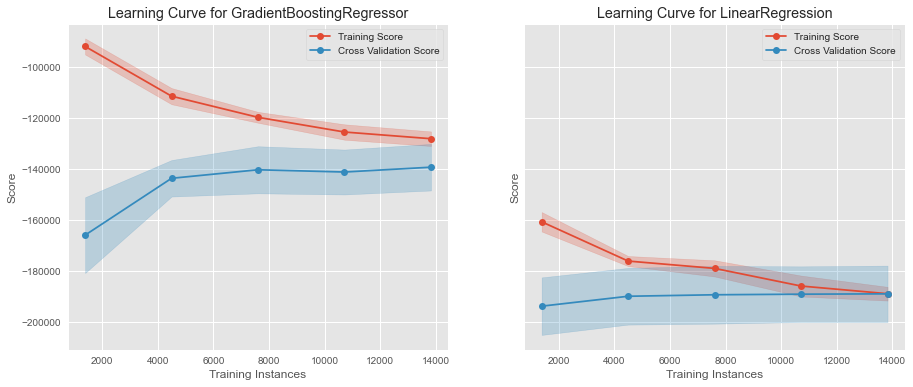

In [42]:
with plt.style.context('ggplot'):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6), sharey=True)
    
    # gradient boost regressor learning curve
    model_lc = LearningCurve(model, cv=5, n_jobs=5, scoring='neg_root_mean_squared_error', ax=ax1, title=f'Learning Curve for {type(model.named_steps["GradientBoostingRegressor"].regressor).__name__}')
    model_lc.fit(X_train, y_train)
    model_lc.finalize()

    # baseline learning curve
    baseline_lc = LearningCurve(baseline, cv=5, n_jobs=5, scoring='neg_root_mean_squared_error', ax=ax2, title=f'Learning Curve for {type(baseline.named_steps["LinearRegression"].regressor).__name__}')
    baseline_lc.fit(X_train, y_train)
    baseline_lc.finalize()
    
    plt.show()

**Observations**

- For Gradient Boosting, we can see a gap, variance, between training score and cross validation score
    - some variance between training and validation score indicates the model might be overfitting
- For Linear Regression, we can see that 
    - there are indication of bias, model is underfitting

---

## Hyperparameter Tuning - Gradient Boosting

A little background behind Hyperparameter Tuning, initially there are two main methods of tuning Hyperparameter, `GridSearchCV` and `RandomizedSearchCV`. `GridSearchCV` is an exhautive search function which compares every Hyperparameters using brute force, while RandomizedSearchCV has selects the Hyperparameters based on sampling methods.

Earlier this year, sklearn 0.24 update came with HalvingGridSearch, a new way to do Hyperparameter Tuning. HalvingGridSearchCV works by giving every combination a small amount of resources and see how well it fare, those who've did well will go through the next iteration. Online articles have shown that HalvingGridSearchCV is apparently 11 times faster than GridSearchCV. As such, I will be using this method to run Hyperparameter Tuning.

Hyperparameters to be tuned:

- regressor__n_estimators - how many trees we want in the model
- regressor__max_depth - how large each tree should be, generally for gradient boosting we want to keep this Hyperparameter low
- regressor__learning_rate - how fast should each tree learn, generally there is a trade off between learning rate and n_estimators
- regressor__subsample - percentage of learners used for fitting, used to reduce variance (overfitting)

In [31]:
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import GridSearchCV
from sklearn.experimental import enable_halving_search_cv
from sklearn.model_selection import HalvingGridSearchCV

In [32]:
grid = {
    'regressor__n_estimators': np.arange(100, 2101, 200),
    'regressor__max_depth': [3, 5, 10],
    'regressor__learning_rate': [.001, .01, .1],
    'regressor__subsample': [.5, .75, 1]
}

model_tuning = Pipeline(
    steps=[
        ('LogTransform', LogTransform),
        ('Normalisation', scaler),
        ('GridSearch', HalvingGridSearchCV(
            TransformedTargetRegressor(
                regressor=GradientBoostingRegressor(), 
                func=np.log1p, 
                inverse_func=np.expm1
            ),
            grid,
            scoring='neg_root_mean_squared_error',
            n_jobs=4,
            verbose=1,
            cv=5,
            aggressive_elimination=True,
            factor=5
        ))
    ]
)

model_tuning.fit(X_train, y_train)
print('Finish Tuning')

n_iterations: 4
n_required_iterations: 4
n_possible_iterations: 4
min_resources_: 138
max_resources_: 17290
aggressive_elimination: True
factor: 5
----------
iter: 0
n_candidates: 297
n_resources: 138
Fitting 5 folds for each of 297 candidates, totalling 1485 fits
----------
iter: 1
n_candidates: 60
n_resources: 690
Fitting 5 folds for each of 60 candidates, totalling 300 fits
----------
iter: 2
n_candidates: 12
n_resources: 3450
Fitting 5 folds for each of 12 candidates, totalling 60 fits
----------
iter: 3
n_candidates: 3
n_resources: 17250
Fitting 5 folds for each of 3 candidates, totalling 15 fits
Finish Tuning


In [33]:
print(model_tuning.named_steps['GridSearch'].best_estimator_)
print(model_tuning.named_steps['GridSearch'].best_params_)
print(model_tuning.named_steps['GridSearch'].best_score_)

TransformedTargetRegressor(func=<ufunc 'log1p'>, inverse_func=<ufunc 'expm1'>,
                           regressor=GradientBoostingRegressor(learning_rate=0.01,
                                                               max_depth=5,
                                                               n_estimators=1700,
                                                               subsample=0.5))
{'regressor__learning_rate': 0.01, 'regressor__max_depth': 5, 'regressor__n_estimators': 1700, 'regressor__subsample': 0.5}
-117994.0405785848


In [34]:
 # initiate model and fitting to training set
model_tuned = Pipeline(
    steps=[
        ('LogTransform', LogTransform),
        ('Normalisation', scaler),
        ('GradientBoostingRegressor', model_tuning.named_steps['GridSearch'].best_estimator_)
    ]
)
model_tuned.fit(X_train, y_train)
tuned_cv = cross_validate(model_tuned, X_train, y_train, scoring=scoring, cv=10, n_jobs=5, return_train_score=True)
display(pd.DataFrame(tuned_cv).append(pd.Series(pd.DataFrame(tuned_cv).mean(), name='mean')).style.apply(
    lambda x: ['background-color: yellow; color: black' if v else '' for v in x == x.max()]
    ).apply(lambda x: ['background-color: orange; color: black' if v else '' for v in x == x.min()]))

,fit_time,score_time,test_rmse,train_rmse,test_mse,train_mse,test_mae,train_mae,test_mape,train_mape,test_r2,train_r2
0,58.020123,0.086810,-110287.796549,-87873.777194,-12163398067.710070,-7721800718.262233,-61515.395022,-54170.718904,-0.118382,-0.102288,0.886237,0.944583
1,58.176704,0.087764,-117862.225627,-88627.326801,-13891504229.817755,-7854803055.889638,-64520.221175,-54287.466055,-0.117352,-0.102720,0.900445,0.942129
2,58.281422,0.093752,-98768.254392,-87822.022752,-9755168075.591537,-7712707680.333038,-60578.050622,-54082.529809,-0.119683,-0.102097,0.906017,0.944788
3,58.017130,0.084772,-116473.516912,-86506.531990,-13566080141.864235,-7483380076.901083,-66075.221596,-53647.512098,-0.125963,-0.101600,0.891767,0.945500
4,58.214603,0.090756,-124313.669620,-87320.854488,-15453888454.413439,-7624931628.540487,-67124.217803,-54041.453211,-0.126047,-0.101981,0.889574,0.943804
5,60.932899,0.089795,-124958.690351,-87206.978229,-15614674294.295811,-7605057051.759262,-66906.700463,-53994.433041,-0.116382,-0.102672,0.898286,0.943301
6,60.717511,0.085773,-118840.468054,-87202.945720,-14123056847.316528,-7604353742.278698,-66214.891106,-53877.349898,-0.116922,-0.102432,0.899703,0.943916
7,60.910029,0.091722,-144092.200695,-87013.045983,-20762562300.984791,-7571270171.312674,-66096.589442,-53847.869237,-0.120852,-0.102074,0.876179,0.942904
8,61.028681,0.089792,-105036.102393,-88329.979208,-11032582805.893982,-7802185226.871255,-59575.494770,-54421.928143,-0.115063,-0.102637,0.902189,0.943735
9,60.828215,0.090758,-125697.542534,-86993.869298,-15799872199.030666,-7567933295.381018,-68442.750493,-53871.027080,-0.125585,-0.102213,0.906794,0.942832


---

## Model Evaluation

Now I want to evaluate GradientBoosting with HyperParameters. Here are some of the content I will be covering,

- Validation Curve
- Learning Curve
- Prediction Error Plot
- Residual Plots
- Feature Importance

We can see that RMSE have improved drastically with the Hyperparameters passed in as arguements.

### Validation Curve

Here we want to measure a models performance by checking how well it fairs with a range of Hyperparameters, and validate the Hyperparameters are accurate

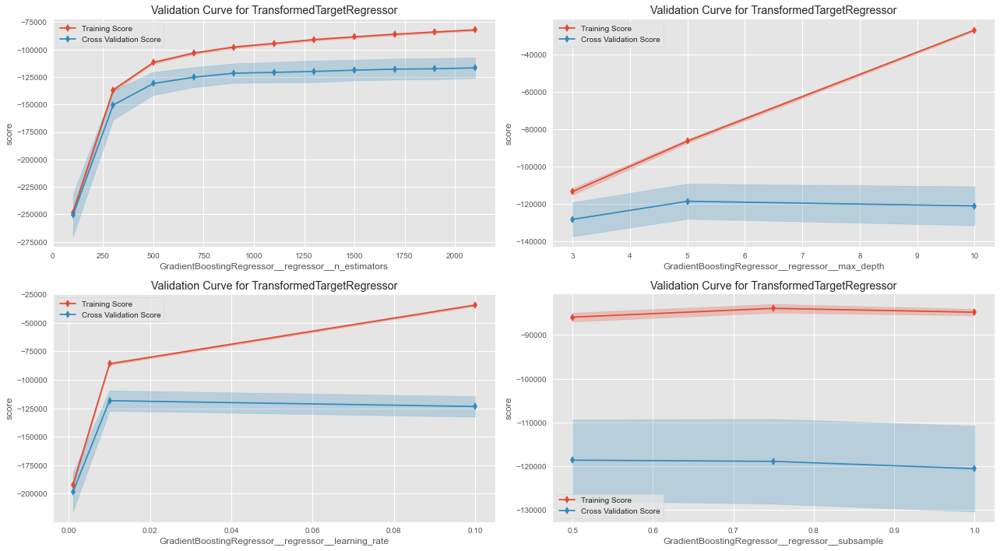

In [35]:
with plt.style.context('ggplot'):
    fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(18, 10), tight_layout=True)
    # n_estimators
    n_est = ValidationCurve(model_tuned, "GradientBoostingRegressor__regressor__n_estimators", grid['regressor__n_estimators'], cv=5, n_jobs=5, ax=ax1, scoring='neg_root_mean_squared_error')
    n_est.fit(X_train, y_train)
    n_est.finalize()
    # max_depth
    max_d = ValidationCurve(model_tuned, "GradientBoostingRegressor__regressor__max_depth", grid['regressor__max_depth'], cv=5, n_jobs=5, ax=ax2, scoring='neg_root_mean_squared_error')
    max_d.fit(X_train, y_train)
    max_d.finalize()
    # learning rate
    learn_r = ValidationCurve(model_tuned, "GradientBoostingRegressor__regressor__learning_rate", grid['regressor__learning_rate'], cv=5, n_jobs=5, ax=ax3, scoring='neg_root_mean_squared_error')
    learn_r.fit(X_train, y_train)
    learn_r.finalize()
    # sub sample
    sub_sample = ValidationCurve(model_tuned, "GradientBoostingRegressor__regressor__subsample", grid['regressor__subsample'], cv=5, n_jobs=5, ax=ax4, scoring='neg_root_mean_squared_error')
    sub_sample.fit(X_train, y_train)
    sub_sample.finalize()

**Observation**

Here we want to keep an eye on `n_estimators`, the rest of the hyperparameters are used as stabilizers to prevent the model is overfitting too much. Here we can see that n_estimators is quite stable, score is not volatile, indicating the hyperparameter is valid. 

### Learning Curve

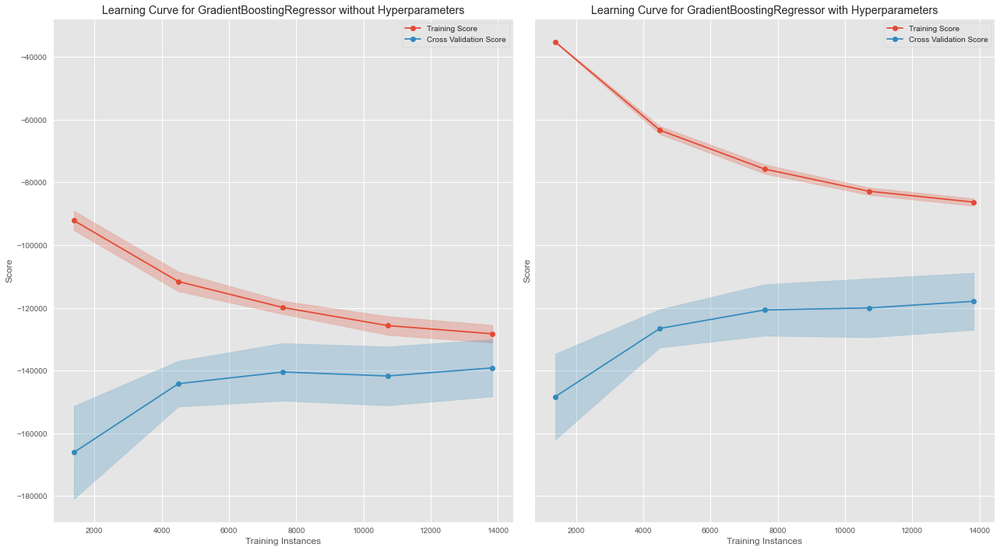

In [36]:
with plt.style.context('ggplot'):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 10), tight_layout=True, sharey=True)

    lc = LearningCurve(model_tuned, cv=5, n_jobs=5, scoring='neg_root_mean_squared_error', ax=ax2, title=f'Learning Curve for {type(model.named_steps["GradientBoostingRegressor"].regressor).__name__} with Hyperparameters')
    lc.fit(X_train, y_train)
    lc.finalize()

    model_lc = LearningCurve(model, cv=5, n_jobs=5, scoring='neg_root_mean_squared_error', ax=ax1, title=f'Learning Curve for {type(model.named_steps["GradientBoostingRegressor"].regressor).__name__} without Hyperparameters')
    model_lc.fit(X_train, y_train)
    model_lc.finalize()

**Observation**

- Generally, we can see that the hyperparameters have improved the scores overall
- however, we can see variance between the training score and cross validation score increased as well
    - this is expected since we are using GradientBoostingRegressor

### Generating Predictions

In [37]:
pred = model_tuned.predict(X_test)
scores = [[
    mean_squared_error(y_test, pred, squared=False),
    mean_squared_error(y_test, pred),
    mean_absolute_error(y_test, pred),
    mean_absolute_percentage_error(y_test, pred),
    r2_score(y_test, pred)
]]
pd.DataFrame(scores, columns=['RMSE', 'MSE', 'MAE', 'MAPE', 'R2'], index=['GradientBoostingRegressor'])

,RMSE,MSE,MAE,MAPE,R2
GradientBoostingRegressor,112580.789489,1.267443e+10,64669.690289,0.121199,0.902068


Our RMSE is around 114K, relatively it did well compared to the cross validation score. 90% R2 indicates the model is a very good fit thus far.

### Error Prediction Plot

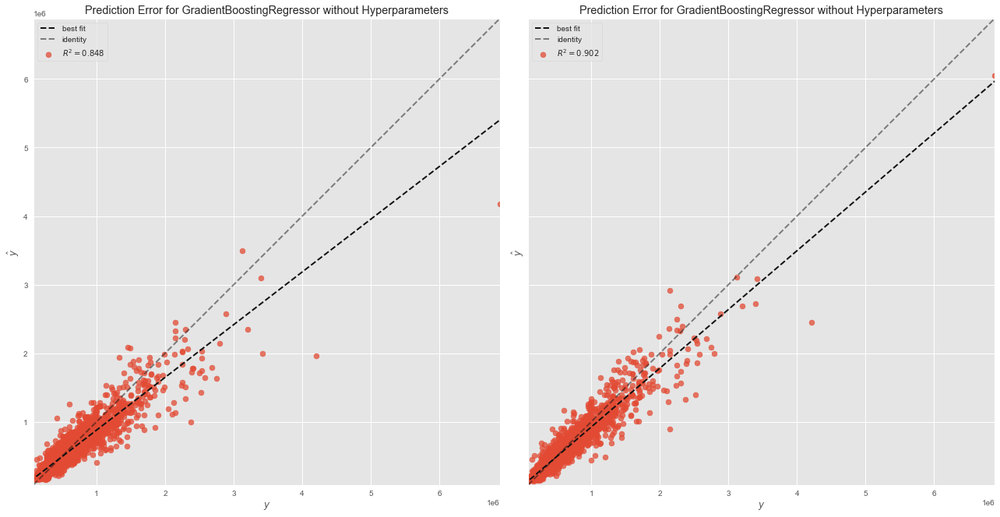

In [38]:
from yellowbrick.regressor import PredictionError

with plt.style.context('ggplot'):
    fig, ax = plt.subplots(1, 2, figsize=(18, 10), sharey=True, tight_layout=True)
    # before tuning
    b_pred_err = PredictionError(model, ax=ax[0], title=f'Prediction Error for {type(model.named_steps["GradientBoostingRegressor"].regressor).__name__} without Hyperparameters')
    b_pred_err.fit(X_train, y_train)
    b_pred_err.score(X_test, y_test)
    b_pred_err.finalize()
    # after tuning
    pred_err = PredictionError(model_tuned, ax=ax[1], title=f'Prediction Error for {type(model_tuned.named_steps["GradientBoostingRegressor"].regressor).__name__} without Hyperparameters')
    pred_err.fit(X_train, y_train)
    pred_err.score(X_test, y_test)
    pred_err.finalize()

 **Observation**

 - we can see the best fit line goes closer to the identiy line, meaning the model performance improved overall after hyperparameter tuning
 - it is hard to visualise, but there is lesser predicted outliers

### Residual Plot

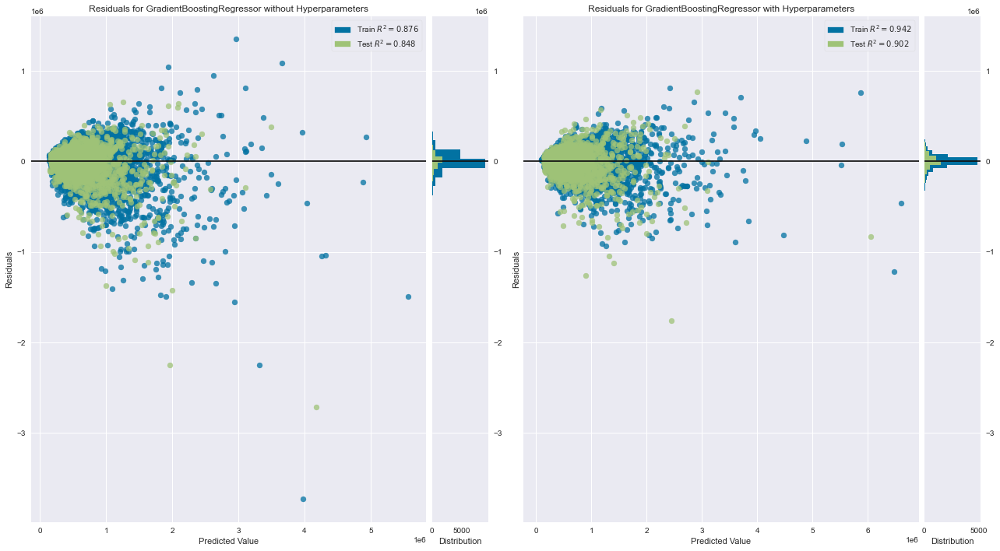

In [39]:
with plt.style.context('seaborn'):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 10), sharey=True, tight_layout=True)

    # residual plots for gradient boosting without hyperparams
    b_res = ResidualsPlot(model, ax=ax1, title=f'Residuals for {type(model.named_steps["GradientBoostingRegressor"].regressor).__name__} without Hyperparameters')
    b_res.fit(X_train, y_train)
    b_res.score(X_test, y_test)
    b_res.finalize()

    # residual plots for gradient boosting with hyperparams
    res = ResidualsPlot(model_tuned, ax=ax2, title=f"Residuals for {type(model_tuned.named_steps['GradientBoostingRegressor'].regressor).__name__} with Hyperparameters")
    res.fit(X_train, y_train)
    res.score(X_test, y_test)
    res.finalize()

Before Hyperparameter tuning, we can see that the predicted values are quite spread out all over the place, the histogram also indicate the same thing. Whereas after tuning, the points are more clustered together, the histogram shows the an increase in kurtosis smaller skewness.

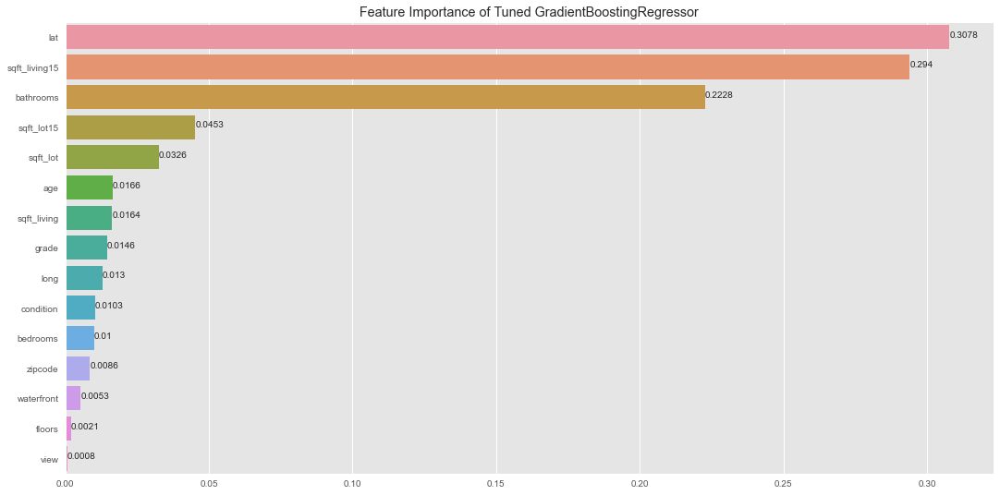

In [40]:
# retrieving feature importance from the regressor
importance=pd.Series(model_tuned.named_steps['GradientBoostingRegressor'].regressor_.feature_importances_, index=X_train.columns).sort_values(ascending=False)
# plotting out feature importance
with plt.style.context('ggplot'):
    fig, ax = plt.subplots(figsize=(18, 9))
    sns.barplot(x=importance.values, y=importance.index, ax=ax)
    ax.set_title('Feature Importance of Tuned {}'.format('GradientBoostingRegressor'))
    [ax.text(x=v, y=i, s=round(v, 4)) for i, v in zip(np.arange(0, len(importance)), importance.values)]
    plt.show()

**Observations**

Is it possible to say something about which features the model considers important?

- After extracting feature importance, we can see that sqft_living15, lat and bathrooms is one of the more important features in predicting house prices (shocking to me)
- we can see age to be somewhat important in predicting house prices, meaning our engineered feature worked well :)

---

## Exporting Model

Note to self: Approximately 35/40 minutes to run until here.

In [41]:
import pickle
os.makedirs('./assets/models', exist_ok=True)
with open('./assets/models/house_model.pkl', 'wb') as file:
    pickle.dump(model_tuned, file)

---

## Forenote

In conclusion, I would say the model fair well, with 112580 RMSE and 90.2% R-Squared. Seeing Lat, sqft_living15 and bathrooms are the most important features, it shows that location, house sizes and amenities do come into consideration when evaluating the price of the house. One thing I would like to improve is implementing Geospatial Mapping using Geopandas to properly represent geographical coordinates.


Overall, this assignment wasn't easy. I found difficulty in this dataset was modelling and hyperparameter tuning due to the very long training time in a regression task. I would say in the end, this part of the assignment was a great challenge for me in the end.

Side-note: my machine crashed multiple instances during the attempt of this assignemnt